In [1]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.io.wavfile import read
from scipy.fft import fft, fftfreq, fftshift
from scipy.signal import kaiserord, firwin, lfilter
from IPython.display import Audio

# Filtros adaptativos

El principio de operación de un filtro adaptativo son sus características variables en el tiempo. Un filtro adaptativo usualmente toma la forma de un filtro FIR, con un algoritmo de adaptación que continuamente actualiza los coeficientes del filtro, tal que la señal de error se minimiza de acuerdo a cierto criterio. La señal de error usualmente es derivada de alguna manera desde diagrama de flujo de la aplicación, tal que sea una medida de qué tan cerca el filtro está del óptimo. [1]

<p style="text-align: center;"><img src="https://www.researchgate.net/profile/Cila_Umat4/publication/224091946/figure/download/fig2/AS:667588824686609@1536176987876/Block-diagram-of-adaptive-filter-11.png"></p>

## Least Mean Squares (LMS)

El algoritmo de los mínimos cuadrados medios es extremadamente popular por su simplicidad y baja complejidad computacional. El algoritmo está basado en el método de gradiente descendiente, pero es aún más simple ya que solo ejecuta una iteración por muestra, y además, calcula solo un estimado del vector gradiente por cada muestra, los coeficientes del filtro se calculan mediante la siguiente ecuación.
<p style="text-align: center;"> $w_{n+1}(i) = w_n (i) + 2 \mu e_n x_{n-i}$, para $i$ desde $0$ hasta $N - 1$ </p>

La variable $w$ son los coeficientes del filtro, que se actualizan con cada iteración del algoritmo, la variable $x$ es la señal de entrada del filtro, mientras que $y$ es la salida del filtro, la cual se utiliza para calcular el error en cada iteración e ir reduciendo su valor. El parámetro $\mu$ es una constante que regula la estabilidad y rapidez de convergencia, para calcular el valor del error se usa:
<p style="text-align: center;"> $e_n = d_n - \sum\limits_{i=0}^{N-1} w(i) \cdot x_{n-i}$ </p>

### 1. Escriba un programa que cargue el archivo `voices.wav` el cual contiene un audio con diversas voces, grafique la señal, nombrando los ejes de manera adecuada y poniendo un título respectivo a la gráfica, finalmente reproduzca el audio.

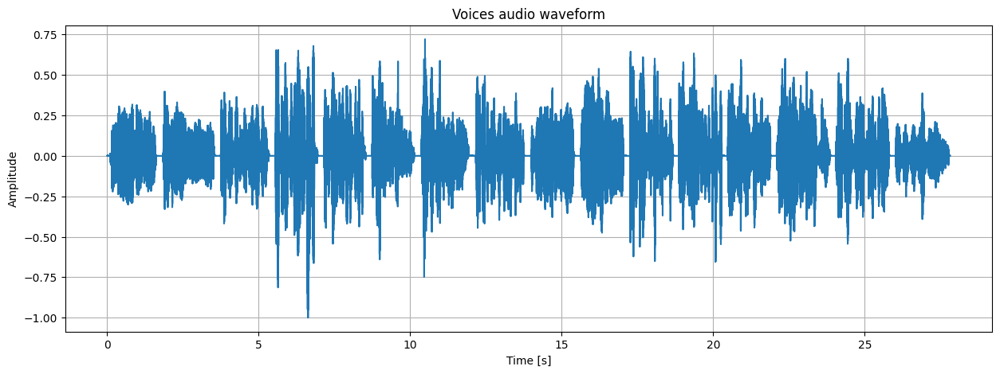

In [19]:
# Cargar el audio
fs, voices = read("voices.wav")


# Función para normalizar
def normalize(x):
    return x / float(max(abs(x)))


# Normalizar el audio
voices = normalize(voices)

t1 = np.arange(0, float(len(voices))/fs, 1.0/fs)

# Graficar
plt.figure(figsize=(15, 5))
plt.plot(t1, voices)
plt.title("Voices audio waveform")
plt.xlabel("Time [s]")
plt.ylabel("Amplitude")
plt.grid()
plt.show()

# Reproducir audio
Audio(voices, rate=fs)

### 2. Escriba un programa que cargue el archivo `rock.wav` el cual contiene una pista musical, grafique la señal, nombrando los ejes de manera adecuada y poniendo un título respectivo a la gráfica, finalmente reproduzca el audio.

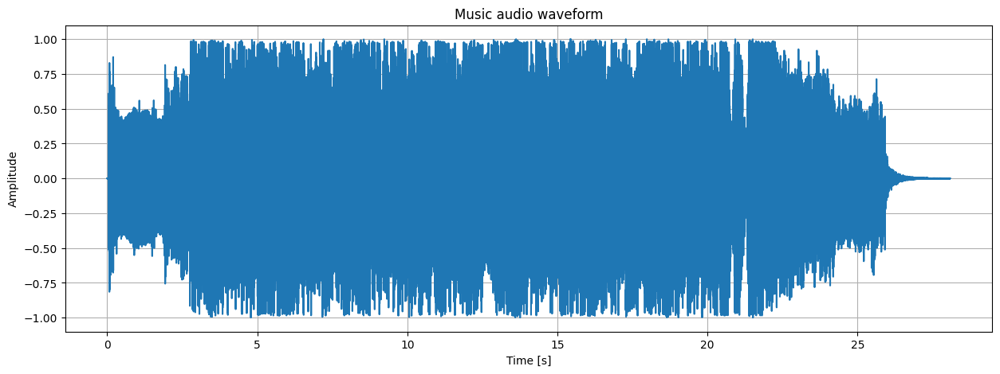

In [3]:
# Cargar el audio
fs, rock = read("rock.wav");

rock = normalize(rock)

t2 = np.arange(0, float(len(rock))/fs, 1.0/fs)

# Graficar
plt.figure(figsize=(15, 5))
plt.plot(t2, rock)
plt.title("Music audio waveform")
plt.xlabel("Time [s]")
plt.ylabel("Amplitude")
plt.grid()
plt.show()

# Reproducir audio
Audio(rock, rate=fs)

### 3. Realice la tarea de combinar los dos audios, asegurándose de que terminen al mismo tiempo sin alterar la longitud del audio más largo, reproduzca el resultado ¿Logra distinguir ambos audios?

In [4]:
L = max(len(voices), len(rock))
rock = np.pad(rock, [0, L - len(rock)])
voices = np.pad(voices, [L - len(voices), 0])
combined = voices + rock

Audio(combined, rate=fs)

Las voces se altamente eclipsadas por la pista musical, ya que su volumen era más bajo. Esto se evidenciaba claramente en la forma de onda, donde el audio musical mantenía una amplitud más alta durante un período mucho más largo que el audio de las voces.

### 4. Grafique el espectro de los audios por separado ¿Qué filtro utilizaría para intentar separar la voz del audio?

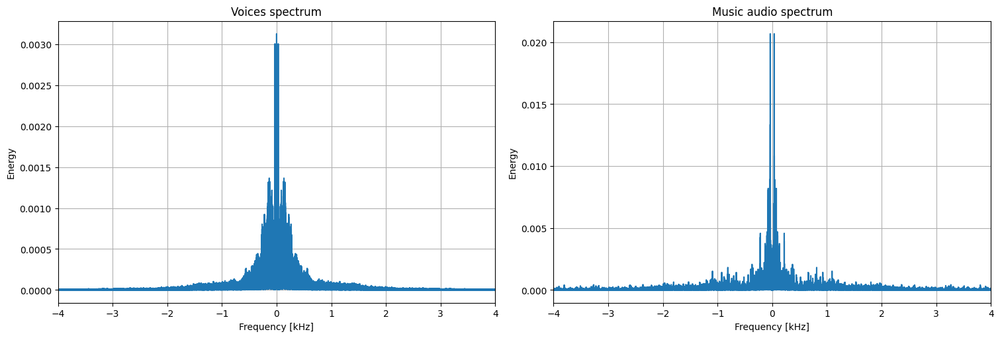

In [5]:
def spectrum(x, fs):
    N = int(2**np.ceil(np.log2(len(voices))))
    X = fftshift(fft(x, N, norm="forward"))
    f = fftshift(fftfreq(len(X)))*fs/2
    return f, X


freqs_voices, fft_voices = spectrum(voices, fs)
freqs_rock, fft_rock = spectrum(rock, fs)

# Graficar
plt.figure(figsize=(15, 5), layout="constrained")

plt.subplot(1, 2, 1)
plt.plot(freqs_voices/1e3, np.abs(fft_voices))
plt.title("Voices spectrum")
plt.xlabel("Frequency [kHz]")
plt.ylabel("Energy")
plt.xlim(-4, 4)
plt.grid()

plt.subplot(1, 2, 2)
plt.plot(freqs_rock/1e3, np.abs(fft_rock))
plt.title("Music audio spectrum")
plt.xlabel("Frequency [kHz]")
plt.ylabel("Energy")
plt.xlim(-4, 4)
plt.grid()

plt.show()

Sugerir un filtro específico y una frecuencia de corte para extraer exclusivamente las voces del audio resulta complicado. Sin embargo, una opción podría ser utilizar un filtro pasabajas con una frecuencia de corte establecida en 800 Hz.

### 4. Según su respuesta al numeral anterior implemente un filtro FIR con esas características, grafique la forma de onda y el espectro del resultado del filtro, reproduzca el audio filtrado ¿Fue posible remover la música usando este filtro? Para implementar el filtro puede utilizar una de las siguientes funciones.

In [6]:
def low_pass_filter(fs, cutoff_hz, roll_off, ripple_dB):
    nyq_rate = fs / 2.0
    width = roll_off/nyq_rate
    N, _ = kaiserord(ripple_dB, width)
    taps = firwin(N, cutoff_hz/nyq_rate, pass_zero="lowpass")
    return taps


def high_pass_filter(fs, cutoff_hz, roll_off, ripple_dB):
    nyq_rate = fs / 2.0
    width = roll_off/nyq_rate
    N, _ = kaiserord(ripple_dB, width)
    taps = firwin(N, cutoff_hz/nyq_rate, pass_zero="highpass")
    return taps

# Para aplicar el filtro se puede usar lfilter:
# taps = low_pass_filter(44100, 1500, 200, 60)
# fir_filtered = lfilter(taps, 1.0, x)

In [7]:
fc = 800

roll_off = 200
ripple_dB = 60

taps = low_pass_filter(fs, fc, roll_off, ripple_dB)

In [8]:
fir_filtered = lfilter(taps, 1.0, combined)

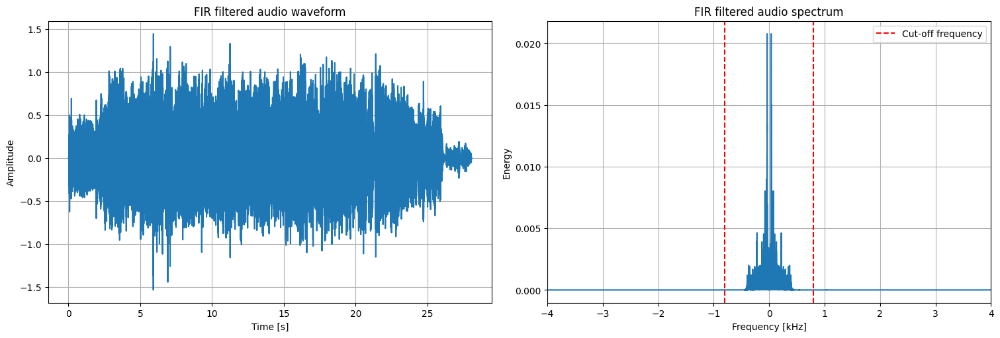

In [9]:
freqs_fir, fft_fir = spectrum(fir_filtered, fs)

# Graficar
plt.figure(figsize=(15, 5), layout="constrained")

plt.subplot(1, 2, 1)
plt.plot(t2, fir_filtered)
plt.title("FIR filtered audio waveform")
plt.xlabel("Time [s]")
plt.ylabel("Amplitude")
plt.grid()

plt.subplot(1, 2, 2)
plt.plot(freqs_fir/1e3, np.abs(fft_fir))
plt.axvline(800/1e3, linestyle="dashed", color="red", label="Cut-off frequency")
plt.axvline(-800/1e3, linestyle="dashed", color="red")
plt.title("FIR filtered audio spectrum")
plt.xlabel("Frequency [kHz]")
plt.ylabel("Energy")
plt.xlim(-4, 4)
plt.legend(loc="upper right")
plt.grid()

In [10]:
Audio(fir_filtered, rate=fs)

Lamentablemente, con el filtro FIR pasa-bajas, solo se logró reducir ligeramente el volumen de la música, pero no se pudo eliminar por completo.

### 5. Utilice un filtro LMS para filtrar la señal combinada, como parámetro `x` use la señal combinada, como parámetro `d` use la señal de voz individual, y como parámetro `mu` use 0.1, grafique el espectro de las voces originales, y del resultado de los dos filtros para poder comparar, reproduzca el resultado, según el espectro, y el audio resultante ¿Qué resultado se parece más al original? ¿Fue posible aislar las voces? ¿Por qué algunas voces resultaron distorsionadas y otras no? Puede ayudarse de la siguiente función para implementar el filtro LMS.

In [11]:
def lms(x, d, N=4, mu=0.1):
    nIters = min(len(x), len(d)) - N
    # Copia de la señal
    u = np.zeros(N)
    # Coeficientes del filtro
    w = np.zeros(N)
    # Salida del filtro
    y = np.zeros(nIters)
    # Error estimado
    e = np.zeros(nIters)
    for n in range(nIters):
        # Tomar una copia de la señal
        u[1:] = u[:-1]
        u[0] = x[n]
        # Calcular la salida del filtro
        y[n] = np.dot(u, w)
        # Calcular el error estimado
        e_n = d[n] - y[n]
        # Actualizar los pesos del filtro
        w = w + 2*mu * e_n * u
        e[n] = e_n
    return y

In [12]:
lms_filtered = lms(combined, voices, mu=0.1)

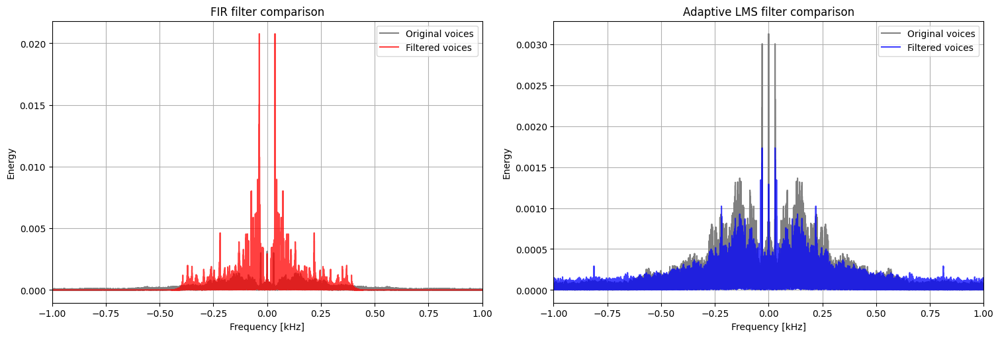

In [13]:
freqs_lms, fft_lms = spectrum(lms_filtered, fs)
t3 = np.arange(0, float(len(lms_filtered))/fs, 1.0/fs)

# Graficar
plt.figure(figsize=(15, 5), layout="constrained")
plt.subplot(1, 2, 1)

plt.plot(freqs_voices/1e3, np.abs(fft_voices), color="gray",
         alpha=1.0, label="Original voices")
plt.plot(freqs_fir/1e3, np.abs(fft_fir), color="red",
         alpha=0.75, label="Filtered voices")

plt.title("FIR filter comparison")
plt.xlabel("Frequency [kHz]")
plt.ylabel("Energy")
plt.xlim(-1, 1)
plt.legend()
plt.grid()

plt.subplot(1, 2, 2)
plt.plot(freqs_voices/1e3, np.abs(fft_voices), color="gray",
         alpha=1.0, label="Original voices")
plt.plot(freqs_lms/1e3, np.abs(fft_lms), color="blue",
         alpha=0.75, label="Filtered voices")

plt.title("Adaptive LMS filter comparison")
plt.xlabel("Frequency [kHz]")
plt.ylabel("Energy")
plt.xlim(-1, 1)
plt.legend()
plt.grid()

plt.show()

In [14]:
Audio(lms_filtered, rate=fs)

Efectivamente, desde el audio se notan las voces con mayor intensidad usando el filtro adaptativo. No obstante, se presentó un inconveniente: las voces resultaron afectadas por el ruido generado por la superposición de la música. A pesar de esto, fue posible extraer exitosamente la última voz, ya que no estaba superpuesta con la pista musical.
En la gráfica del espectro podemos ver que en cada caso el color más oscuro corresponde a la superposición del espectro original y el de la señal filtrada, dicho esto, es sencillo notar que para el filtro tradicional el espectro resultante es muchísimo más enérgico que el original, esto porque la música no fue correctamente filtrada de este.
Por otro lado, en el caso del filtro adaptativo las señales tienen una energía muy similar, además de superponerse durante más frecuencias, resultando en un audio más parecido, aunque distorsionado, esto último puede remediarse mediante posprocesamiento de la señal filtrada.

### 6. Para poder observar mejor el comportamiento del filtro, aplique el filtro al audio combinado para los valores de $\mu$ de 0.001, 0.01, 0.1 y 0.2. Determine de qué manera influye este parámetro en el algoritmo, concluya.

In [15]:
mu = 0.001
lms_filtered1 = lms(combined, voices, mu=mu)
Audio(lms_filtered1, rate=fs)

In [16]:
mu = 0.01
lms_filtered2 = lms(combined, voices, mu=mu)
Audio(lms_filtered2, rate=fs)

In [17]:
mu = 0.1
lms_filtered3 = lms(combined, voices, mu=mu)
Audio(lms_filtered2, rate=fs)

In [18]:
mu = 0.2
lms_filtered4 = lms(combined, voices, mu=mu)
Audio(lms_filtered4, rate=fs)

El filtro no logra atenuar completamente la señal indeseada cuando se utilizan valores bajos para el coeficiente de retroalimentación (μ). Esto se debe a que un valor muy bajo de μ dificulta una convergencia rápida hacia un mínimo de error. En cambio, al utilizar un valor intermedio como 0.1, se observa una buena atenuación en la música, pero no es posible recuperar completamente la energía superpuesta en esas frecuencias, lo que resulta en distorsión en la voz. Por otro lado, al emplear un valor alto de 0.2, la retroalimentación es excesiva y la señal resultante se ve excesivamente atenuada, llegando incluso a ser nula.

## Conclusiones

- Los filtros adaptativos con el algoritmo LMS son capaces de ajustarse y adaptarse a condiciones y entornos variables. Esto les permite seguir eficazmente cambios en las características de la señal o en las condiciones de transmisión, lo que los convierte en una opción robusta para aplicaciones en las que las condiciones pueden cambiar con el tiempo.
- El algoritmo LMS es computacionalmente eficiente y relativamente sencillo de implementar. Lo que lo hace adecuado para aplicaciones en tiempo real con recursos limitados, como escenarios con sistemas embebidos o diversas soluciones IoT.
- La elección adecuada de la constante μ en el algoritmo LMS requiere un enfoque empírico. No existe un valor universalmente óptimo, por lo que se deben realizar pruebas y experimentos para encontrar el valor de μ que minimice el error y permita una adaptación efectiva del filtro en cada situación específica.